In [1]:
import numpy as mp
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

%matplotlib inline
import warnings
warnings.filterwarnings('ignore')

df = pd.read_csv(r'D:\PTA\Airbnb\listings_summary_2024_11.csv', encoding='latin1')
df.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,...,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license,Unnamed: 18,Unnamed: 19,Unnamed: 20
0,2595,Skylit Midtown Castle Sanctuary,2845,Jennifer,Manhattan,Midtown,40.75356,-73.98559,Entire home/apt,240,...,49,2022/6/21,0.27,3,365,0,NaN,NaN,NaN,NaN
1,6848,Only 2 stops to Manhattan studio,15991,Allen & Irina,Brooklyn,Williamsburg,40.70935,-73.95342,Entire home/apt,83,...,195,2024/10/5,1.04,1,185,4,NaN,NaN,NaN,NaN
2,6872,Uptown Sanctuary w/ Private Bath (Month to Month),16104,Kae,Manhattan,East Harlem,40.80107,-73.94255,Private room,65,...,1,2022/6/5,0.03,2,83,0,NaN,NaN,NaN,NaN
3,6990,UES Beautiful Blue Room,16800,Cyn,Manhattan,East Harlem,40.78778,-73.94759,Private room,71,...,250,2024/10/31,1.37,1,284,4,NaN,NaN,NaN,NaN
4,7064,"Amazing location! Wburg. Large, bright & tranquil",17297,Joelle,Brooklyn,Williamsburg,40.71248,-73.95881,Private room,NaN,...,13,2022/9/12,0.08,2,0,0,NaN,NaN,NaN,NaN


In [3]:
df.columns

Index(['id', 'name', 'host_id', 'host_name', 'neighbourhood_group',
       'neighbourhood', 'latitude', 'longitude', 'room_type', 'price',
       'minimum_nights', 'number_of_reviews', 'last_review',
       'reviews_per_month', 'calculated_host_listings_count',
       'availability_365', 'number_of_reviews_ltm', 'license', 'Unnamed: 18',
       'Unnamed: 19', 'Unnamed: 20'],
      dtype='object')

In [4]:
unnamed_columns = df[['Unnamed: 18', 'Unnamed: 19', 'Unnamed: 20']]
unnamed_columns.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 37399 entries, 0 to 37398
Data columns (total 3 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Unnamed: 18  8 non-null      object 
 1   Unnamed: 19  3 non-null      object 
 2   Unnamed: 20  1 non-null      float64
dtypes: float64(1), object(2)
memory usage: 876.7+ KB


In [8]:
non_null_data = unnamed_columns.dropna(how='all')
non_null_data

,Unnamed: 18,Unnamed: 19,Unnamed: 20
9671,0,NaN,NaN
14360,0,NaN,NaN
18520,740,354,0.0
20137,0,NaN,NaN
20620,365,1,NaN
20743,OSE-STRREG-0000208,NaN,NaN
22035,38,OSE-STRREG-0000303,NaN
23562,0,NaN,NaN


In [10]:
# When I check these weird values in extra column in Excel, actually I cannot found any of them. Since these Unnamed columns
# contain unexpected an irrelavant data, removing them directly is a valid choice. 

In [12]:
df = df.drop(columns=unnamed_columns)
df = df.drop(col for col in df.columns if 'Unnamed' in col)
df.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
0,2595,Skylit Midtown Castle Sanctuary,2845,Jennifer,Manhattan,Midtown,40.75356,-73.98559,Entire home/apt,240,30,49,2022/6/21,0.27,3,365,0,NaN
1,6848,Only 2 stops to Manhattan studio,15991,Allen & Irina,Brooklyn,Williamsburg,40.70935,-73.95342,Entire home/apt,83,30,195,2024/10/5,1.04,1,185,4,NaN
2,6872,Uptown Sanctuary w/ Private Bath (Month to Month),16104,Kae,Manhattan,East Harlem,40.80107,-73.94255,Private room,65,30,1,2022/6/5,0.03,2,83,0,NaN
3,6990,UES Beautiful Blue Room,16800,Cyn,Manhattan,East Harlem,40.78778,-73.94759,Private room,71,30,250,2024/10/31,1.37,1,284,4,NaN
4,7064,"Amazing location! Wburg. Large, bright & tranquil",17297,Joelle,Brooklyn,Williamsburg,40.71248,-73.95881,Private room,NaN,30,13,2022/9/12,0.08,2,0,0,NaN


In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 37399 entries, 0 to 37398
Data columns (total 18 columns):
 #   Column                          Non-Null Count  Dtype 
---  ------                          --------------  ----- 
 0   id                              37399 non-null  object
 1   name                            37397 non-null  object
 2   host_id                         37398 non-null  object
 3   host_name                       37393 non-null  object
 4   neighbourhood_group             37398 non-null  object
 5   neighbourhood                   37398 non-null  object
 6   latitude                        37398 non-null  object
 7   longitude                       37398 non-null  object
 8   room_type                       37336 non-null  object
 9   price                           22744 non-null  object
 10  minimum_nights                  37383 non-null  object
 11  number_of_reviews               37365 non-null  object
 12  last_review                     25874 non-null

In [16]:
# from ydata_profiling import ProfileReport
# profile = ProfileReport(df, title='Data Profile Report', explorative=True)
# profile

In [18]:
df.describe()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
count,37399,37397,37398,37393,37398,37398,37398.00000,37398,37336,22744,37383,37365,25874,25902,37394,37398,37288,5369
unique,35031,35806,22337,8481,78,342,24368.00000,20884,75,1563,182,640,3233,1239,186,735,248,1922
top,1.0107E+18,Water View King Bed Hotel Room,107434423,Blueground,Manhattan,Bedford-Stuyvesant,40.61881,Private room,Entire home/apt,150,30,0,2024/10/20,0.01,1,0,0,Exempt
freq,25,30,896,896,16373,2691,67.00000,59,19785,530,26519,8373,365,1119,17381,12484,22013,2875


In [20]:
int_columns = ['price', 'minimum_nights', 'number_of_reviews', 'reviews_per_month', 'calculated_host_listings_count', 
               'availability_365', 'number_of_reviews_ltm']
float_columns = ['latitude', 'longitude']
for col in df.columns:
    if col in int_columns:
        df[col] = pd.to_numeric(df[col], errors='coerce').fillna(0).astype('int')
    elif col in float_columns:
        df[col] = pd.to_numeric(df[col], errors='coerce').fillna(0).astype('float')
    else:
        df[col]
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 37399 entries, 0 to 37398
Data columns (total 18 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              37399 non-null  object 
 1   name                            37397 non-null  object 
 2   host_id                         37398 non-null  object 
 3   host_name                       37393 non-null  object 
 4   neighbourhood_group             37398 non-null  object 
 5   neighbourhood                   37398 non-null  object 
 6   latitude                        37399 non-null  float64
 7   longitude                       37399 non-null  float64
 8   room_type                       37336 non-null  object 
 9   price                           37399 non-null  int32  
 10  minimum_nights                  37399 non-null  int32  
 11  number_of_reviews               37399 non-null  int32  
 12  last_review                     

In [22]:
numeric_columns = int_columns + float_columns
df[numeric_columns].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 37399 entries, 0 to 37398
Data columns (total 9 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   price                           37399 non-null  int32  
 1   minimum_nights                  37399 non-null  int32  
 2   number_of_reviews               37399 non-null  int32  
 3   reviews_per_month               37399 non-null  int32  
 4   calculated_host_listings_count  37399 non-null  int32  
 5   availability_365                37399 non-null  int32  
 6   number_of_reviews_ltm           37399 non-null  int32  
 7   latitude                        37399 non-null  float64
 8   longitude                       37399 non-null  float64
dtypes: float64(2), int32(7)
memory usage: 1.6 MB


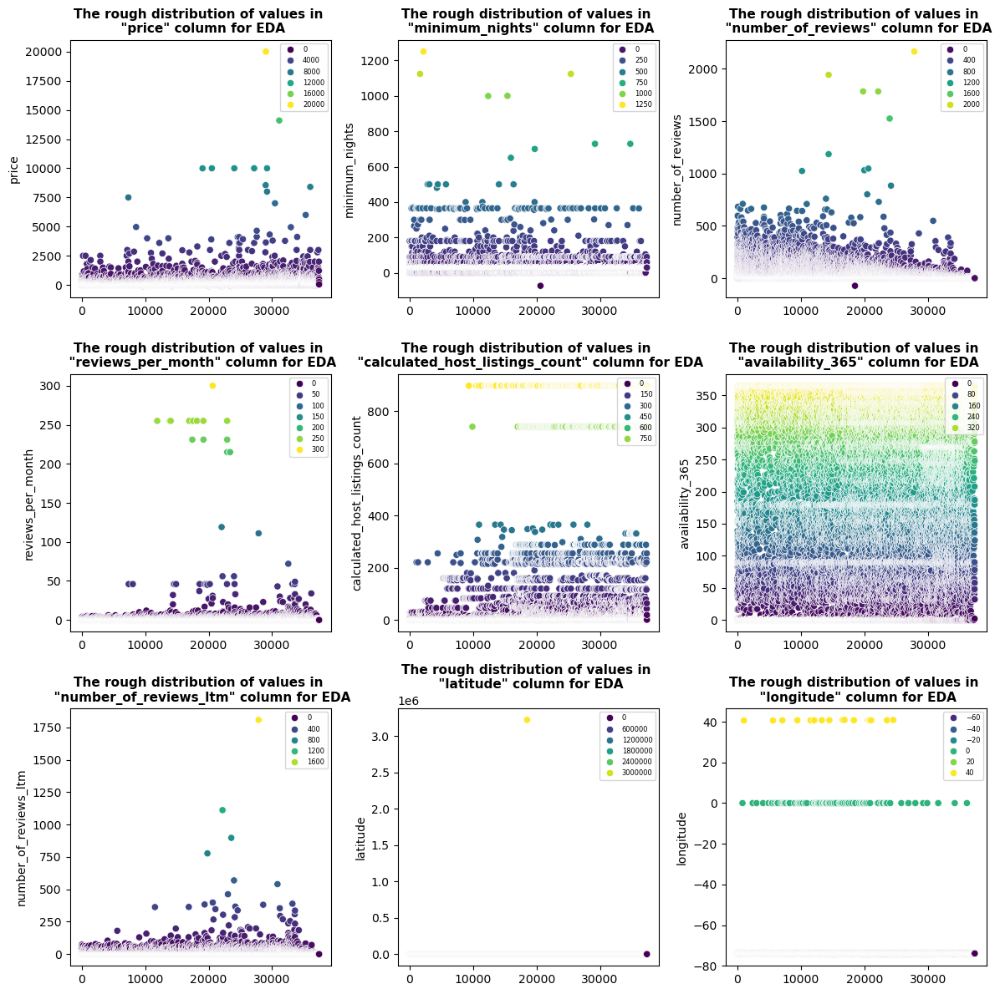

In [24]:
numeric_columns = int_columns + float_columns
fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(12,12))
axes = axes.flatten()
for i, col in enumerate(numeric_columns):
    sns.scatterplot(df, x=df.index, y=df[col], ax=axes[i], hue=df[col], palette='viridis')
    axes[i].legend(fontsize=6, loc='upper right')
    axes[i].set_ylabel(col, size=10)
    axes[i].set_xlabel(None)
    axes[i].set_title(f'The rough distribution of values in \n "{col}" column for EDA', size=11, weight='bold')
for j in range(i+1, len(axes)):
    fig = delaxes(axes[j])
plt.tight_layout()
plt.show()

In [25]:
df['minimum_nights'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 37399 entries, 0 to 37398
Series name: minimum_nights
Non-Null Count  Dtype
--------------  -----
37399 non-null  int32
dtypes: int32(1)
memory usage: 146.2 KB


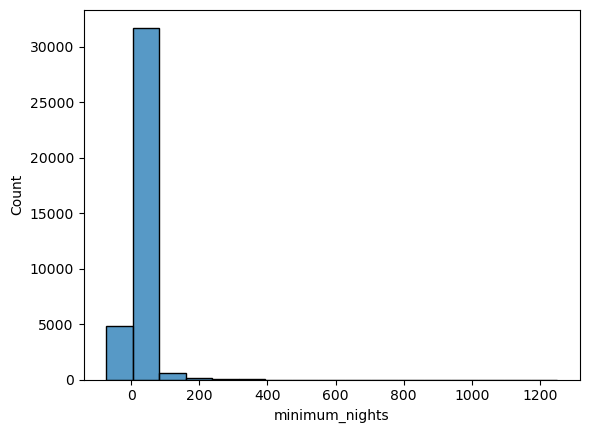

In [28]:
sns.histplot(df, x='minimum_nights')
plt.show()

In [30]:
# So it proves that there is some obvious error values, especially those which are(is) negative.

In [32]:
df[df['minimum_nights']<0]

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
20620,53116201,"Awesome Access! to station, 2min/5 line u can ...",parking on premises,comfy,"quiet""",211392722,0.0,0.0,Morris Park,40,-73,0,599,300,68,0,2,2


In [34]:
df = df[df['minimum_nights']>=0]
df['minimum_nights'].sort_values()

7073        0
9671        0
16600       0
4032        0
1010        0
         ... 
25408    1124
25410    1124
25411    1124
1644     1124
2183     1250
Name: minimum_nights, Length: 37398, dtype: int32

In [36]:
df['number_of_reviews'].sort_values()

18520     -73
24531       0
24529       0
24528       0
24524       0
         ... 
23988    1525
22177    1784
19796    1785
14369    1943
27863    2165
Name: number_of_reviews, Length: 37398, dtype: int32

In [38]:
df = df[df['number_of_reviews']>=0]
df['number_of_reviews'].sort_values()

37398       0
31001       0
12983       0
31000       0
30999       0
         ... 
23988    1525
22177    1784
19796    1785
14369    1943
27863    2165
Name: number_of_reviews, Length: 37397, dtype: int32

In [40]:
df['price'].sort_values()
df = df[df['price']>=0]
df['price'].sort_values()

18698        0
11025        0
11026        0
11027        0
11028        0
         ...  
24031    10000
20493    10000
31115    14097
29013    20000
29012    20000
Name: price, Length: 37392, dtype: int32

In [42]:
room_types = ['Entire home/apt', 'Private room', 'Hotel room', 'Shared room']
df = df[df['room_type'].isin(room_types)]
df['room_type'].value_counts()

room_type
Entire home/apt    19785
Private room       16525
Hotel room           529
Shared room          420
Name: count, dtype: int64

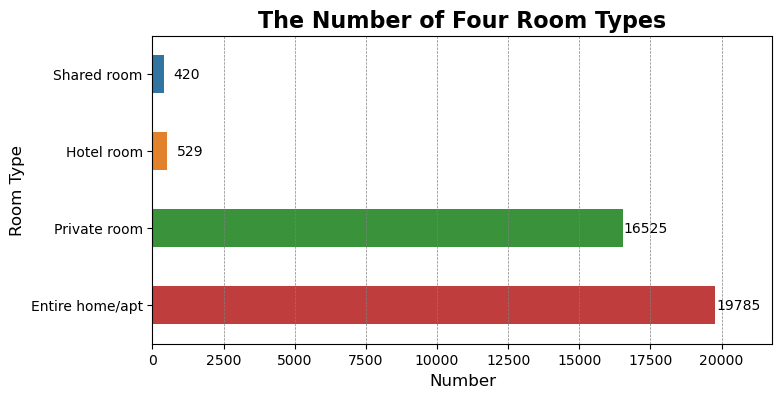

In [44]:
plt.figure(figsize=(8,4))
agg_df = df.groupby('room_type').agg(
    room_type_number = ('room_type', 'count')
).reset_index().sort_values(by='room_type_number', ascending=True)
ax = sns.barplot(agg_df, y='room_type', x='room_type_number', width=0.5, hue='room_type')
for bar in ax.patches:
    xval = bar.get_width()
    plt.text(xval+800, bar.get_y()+bar.get_height()/2, f'{int(xval)}', ha='center', va='center')
ax.set_xlim(0, agg_df['room_type_number'].max()+2000)
plt.xlabel('Number', size=12)
plt.ylabel('Room Type', size=12)
plt.title('The Number of Four Room Types', size=16, weight='bold')
plt.grid(axis='x', color='grey', linestyle='--', linewidth=0.5)
plt.show()

In [46]:
# From the horizontal bar chart, we can conclude that Entire home/apt is the most popular room type.

In [48]:
agg_df_2_minus = df.groupby('room_type').agg(
    room_number = ('room_type', 'count'),
    median_price = ('price', 'median'),
    mean_price = ('price', 'mean'),
    max_price = ('price', 'max'),
    min_price = ('price', 'min')
).reset_index()
percentiles_df = df.groupby('room_type')['price'].quantile([0.25, 0.4, 0.75, 0.9]).unstack()
percentiles_df.columns = ['25th_Percentile', '40th_Percentile', '75th_Percentile', '90th_Percentile']
agg_df_2 = agg_df_2_minus.merge(percentiles_df, on='room_type', how='inner')
agg_df_2['mode_price'] = df.groupby('room_type')['price'].apply(lambda x: x.mode()[0] if not x.mode().empty else None)
agg_df_2_order = [col for col in agg_df_2.columns if col!= 'min_price'] + ['min_price']
agg_df_2 = agg_df_2[agg_df_2_order]
gradient_columns = [col for col in agg_df_2.columns if col not in['room_type', 'min_price', 'mode_price']]
agg_df_2_styled = agg_df_2.style.background_gradient(subset=gradient_columns , axis=0, cmap='Greens')
agg_df_2_styled

,room_type,room_number,median_price,mean_price,max_price,25th_Percentile,40th_Percentile,75th_Percentile,90th_Percentile,mode_price,min_price
0,Entire home/apt,19785,127.000000,174.377255,14097,0.000000,86.600000,240.000000,382.000000,nan,0
1,Hotel room,529,164.000000,287.775047,2099,0.000000,119.200000,410.000000,799.000000,nan,0
2,Private room,16525,46.000000,76.596611,20000,0.000000,0.000000,93.000000,170.000000,nan,0
3,Shared room,420,33.000000,77.211905,7000,0.000000,0.000000,70.000000,149.100000,nan,0


In [50]:
# From the styled table, we can also find that Entire home/apt has the most rooms, indicating its high popularity amongst all. On the other hand, hotel
# room is obviously the most expensive on the whole albeit with a lower maximun price. The highest price belongs to private, 20000. From both popularity
# and price perspective, shared room performed worst. Given that most data flustered from 40th to 90th percentile, I will create a violin plot to show
# the distribution of prices roughly in this range.

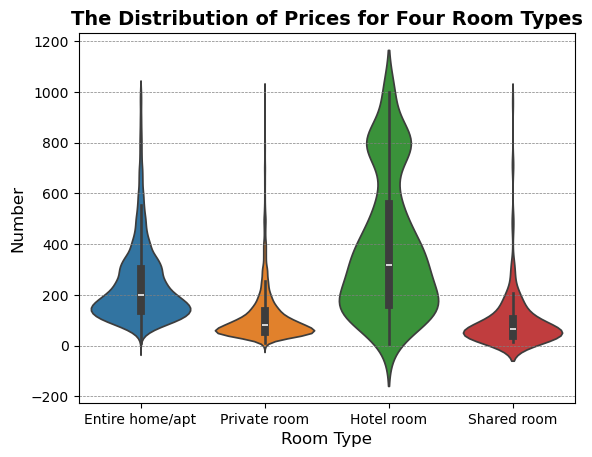

In [52]:
violin_df = df[(df['price']>0)&(df['price']<1000)]
sns.violinplot(violin_df, x='room_type', y='price', hue='room_type')
plt.title('The Distribution of Prices for Four Room Types', size=14, weight='bold')
plt.xlabel('Room Type', size=12)
plt.ylabel('Number', size=12)
plt.grid(axis='y', color='grey', linestyle='--', lw=0.5)
plt.show()

In [54]:
# The violin plot smoothens the data using KDE. This smoothing process sometimes extend beyond the actual range, which is called
# violin plot artifact(伪影).

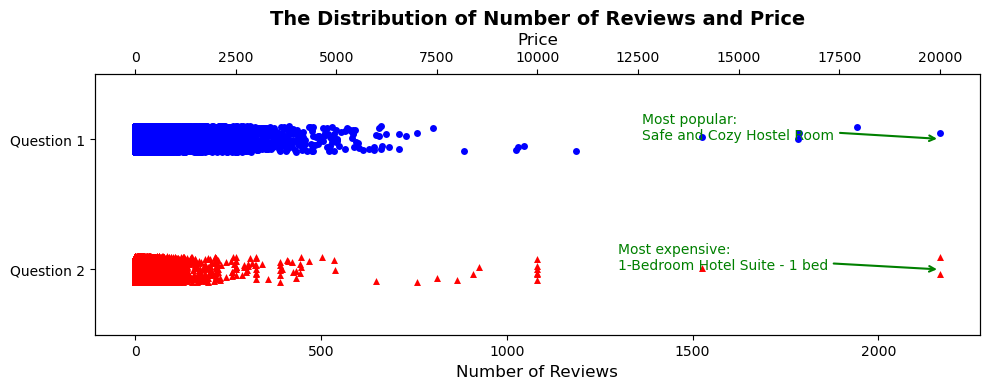

In [68]:
most_popular = df.loc[df['number_of_reviews'].idxmax()]
most_expensive = df.loc[df['price'].idxmax()]

df['strip_1']='Question 1'
df['strip_2']='Question 2'

fig, ax = plt.subplots(figsize=(10,4))
sns.stripplot(df, ax=ax, x='number_of_reviews', y='strip_1', color='blue', jitter=True, marker='o')
ax.set_xlabel('Number of Reviews', size=12)
ax.set_ylabel(None)
ax.set_title('The Distribution of Number of Reviews and Price', size=14, weight='bold')
ax2 = ax.twiny()
sns.stripplot(df, ax=ax2, x='price', y='strip_2', color='red', jitter=True, marker='^')
ax2.set_xlabel('Price', size=12)

ax.annotate(f'Most popular:\n{most_popular['name'].split(',')[0]}',
            xy=(most_popular['number_of_reviews'], most_popular['strip_1']),
            xytext=(most_popular['number_of_reviews']-800, most_popular['strip_1']),
            arrowprops=dict(arrowstyle='->', color='green', lw=1.5),
            color='green'
)
ax2.annotate(f'Most expensive:\n{most_expensive['name']}',
            xy=(most_expensive['price'], most_expensive['strip_2']),
            xytext=(most_expensive['price']-8000, most_expensive['strip_2']),
            arrowprops=dict(arrowstyle='->', color='green', lw=1.5),
            color='green'
)

plt.tight_layout()
plt.show()

In [70]:
# So from the strip plot we can easily find the names of most popular and most expensive room.

In [72]:
df['neighbourhood_group'].value_counts()

neighbourhood_group
Manhattan        16373
Brooklyn         13801
Queens            5492
Bronx             1229
Staten Island      364
Name: count, dtype: int64

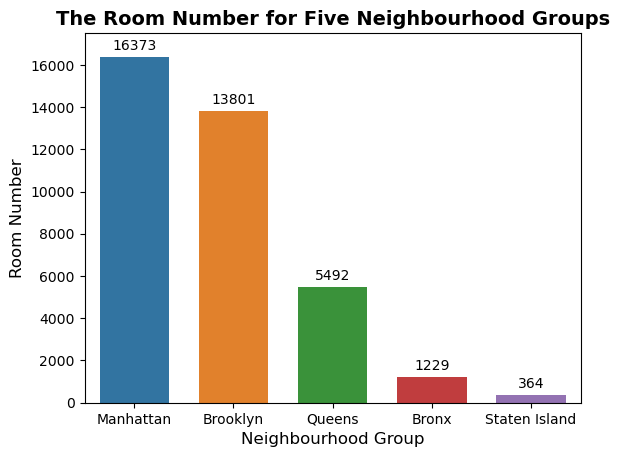

In [74]:
agg_df_3 = df.groupby('neighbourhood_group').agg(
    room_number = ('neighbourhood_group', 'count')
).reset_index().sort_values(by='room_number', ascending=False)
ax = sns.barplot(agg_df_3, x='neighbourhood_group', y='room_number', hue='neighbourhood_group', width=0.7)
for bar in ax.patches:
    yval = bar.get_height()
    ax.text(bar.get_x()+bar.get_width()/2, yval+200, f'{int(yval)}', ha='center', va='bottom', size=10)
plt.ylim(0, 17500)
plt.xlabel('Neighbourhood Group', size=12)
plt.ylabel('Room Number', size=12)
plt.title('The Room Number for Five Neighbourhood Groups', size=14, weight='bold')
plt.show()

In [76]:
# With regard to neighbourhood group, Manhattan has the largest number of rooms, with 16373, followed closedly by Brookyn, with 13801. Staten Island
# has least room number, with merely 364.

In [78]:
df['neighbourhood'].value_counts()

neighbourhood
Bedford-Stuyvesant            2691
Williamsburg                  2149
Midtown                       2039
Harlem                        1757
Bushwick                      1532
                              ... 
Richmondtown                     1
New Dorp                         1
Fort Wadsworth                   1
Chelsea, Staten Island           1
Bay Terrace, Staten Island       1
Name: count, Length: 223, dtype: int64

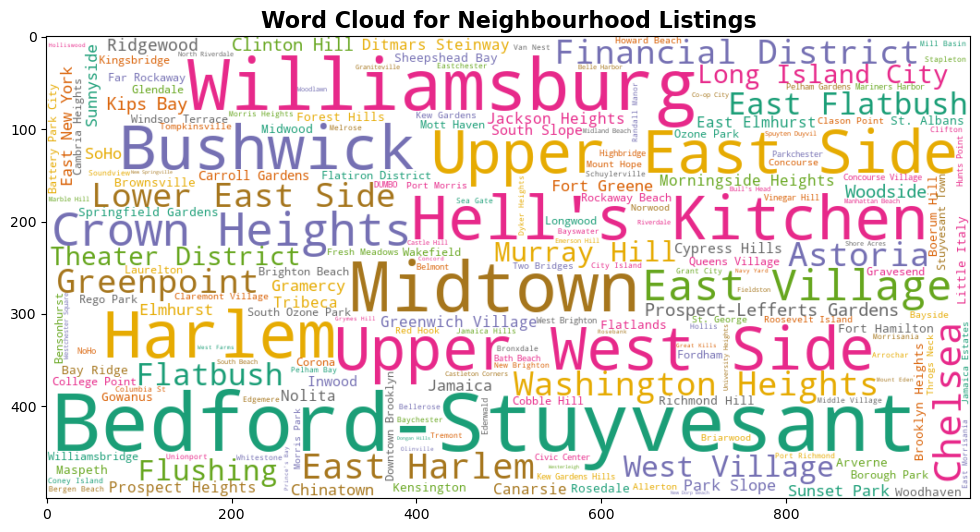

In [80]:
from wordcloud import WordCloud
neighbourhood_series = df['neighbourhood'].value_counts()
neighbourhood_dict = neighbourhood_series.to_dict()
wordcloud = WordCloud(width=1000, height=500, background_color='white', colormap='Dark2').generate_from_frequencies(neighbourhood_dict)
plt.figure(figsize=(12,6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.title('Word Cloud for Neighbourhood Listings', size=16, weight='bold')
plt.show()

In [81]:
# Through the word cloud, we can find that Bedford-Stuyvesant is the neighbourhood that has most rooms. Likewise, Williamsburg and Midtown also
# have more rooms than remaining neighbourhoods because their names are incredibly obvious and large.

In [82]:
#!pip install squarify

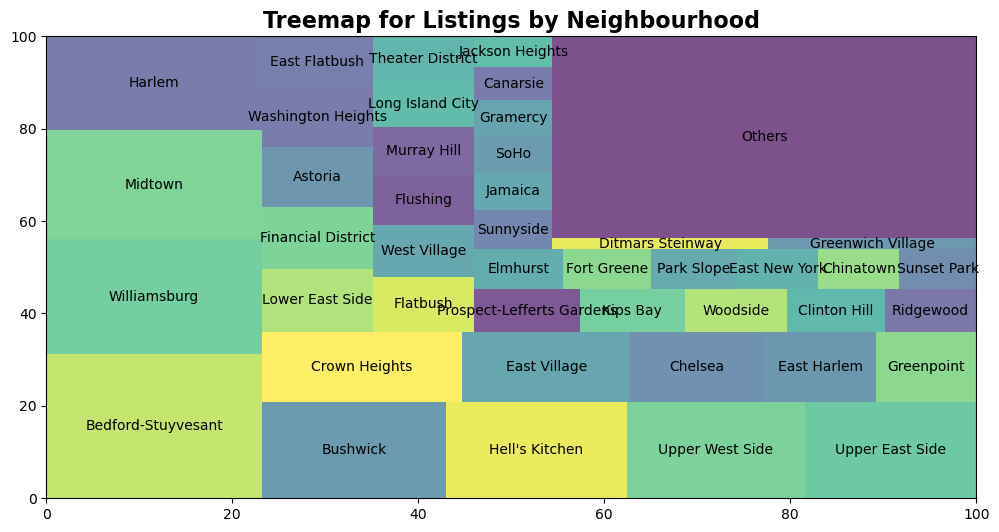

In [86]:
neighbourhood_ss = df['neighbourhood'].value_counts()
threshold = 200
neigh_ss_top = neighbourhood_ss[neighbourhood_ss > threshold]
neigh_ss_others = neighbourhood_ss[neighbourhood_ss <= threshold].sum()
neigh_ss = pd.concat([neigh_ss_top, pd.Series({'Others': neigh_ss_others})])

import squarify
plt.figure(figsize=(12,6))
squarify.plot(sizes=neigh_ss.values, label=neigh_ss.index, alpha=0.7)

plt.title('Treemap for Listings by Neighbourhood', size=16, weight='bold')
plt.show()

In [88]:
# Baed on different diffusion of areas, we know that the rooms were not distributed evenly by neighbourhood.

In [90]:
#df = df.drop(columns=['strip_1', 'strip_2'])
df.columns

Index(['id', 'name', 'host_id', 'host_name', 'neighbourhood_group',
       'neighbourhood', 'latitude', 'longitude', 'room_type', 'price',
       'minimum_nights', 'number_of_reviews', 'last_review',
       'reviews_per_month', 'calculated_host_listings_count',
       'availability_365', 'number_of_reviews_ltm', 'license', 'strip_1',
       'strip_2'],
      dtype='object')

In [92]:
df['latitude'].sort_values()

23405    40.500366
20583    40.504560
22894    40.507114
562      40.508630
18146    40.517070
           ...    
28582    40.906568
31265    40.906670
25679    40.911147
19062    40.911380
8409     40.911390
Name: latitude, Length: 37259, dtype: float64

In [94]:
df['longitude'].sort_values()

22894   -74.251907
20583   -74.249840
562     -74.241350
23405   -74.239401
22648   -74.215140
           ...    
34447   -73.719812
26188   -73.719750
26124   -73.717410
28432   -73.713836
4317    -73.713650
Name: longitude, Length: 37259, dtype: float64

In [96]:
df['price'].sort_values().quantile(0.35) 
#In the dtype converting process, there are many unvalid values being converted to 0, all of which should be omit.

0.0

In [98]:
#pip install folium

In [100]:
map_df = df[df['price']>0]
map_df[['price', 'latitude', 'longitude']].isnull().sum()

price        0
latitude     0
longitude    0
dtype: int64

In [102]:
import folium
from folium.plugins import MarkerCluster

lat_center = map_df['latitude'].mean()
lon_center = map_df['longitude'].mean()

m = folium.Map(location=[lat_center, lon_center], zoom_start=12)
marker_cluster = MarkerCluster().add_to(m)

def get_color(price):
    if price < 50:
        return 'yellow'
    elif 50 <= price < 200:
        return 'orange'
    elif 200 <= price < 1000:
        return 'red'
    else:
        return 'black'

for _, row in map_df.iterrows():
    folium.Marker(
        location = [row['latitude'], row['longitude']],
        popup = f'Price: ${row['price']}',
        icon = folium.Icon(color=get_color(row['price']), icon='info-sign')
    ).add_to(marker_cluster)
m

In [103]:
# Here we must use MarkerCluster method when there are too many rows of data, or the notebook will get stuck!

In [106]:
# Next, I will focus on solving the last question in Section 2. To build a reliable prediction model, I choose to use Random Forest Regression
# and the metrics like MAE, MSE, R2 Score.

In [108]:
df['availability_365'].value_counts() # So I should filter out those 0s?

availability_365
0      12554
365     2230
364      865
363      674
354      665
       ...  
25        14
14        13
9         12
22        11
23         6
Name: count, Length: 366, dtype: int64

In [110]:
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

reg_df = df[(df['price']>0)&(df['price']<df['price'].quantile(0.95))].dropna()
reg_columns = ['price', 'latitude', 'longitude', 'room_type', 'reviews_per_month', 'availability_365']
reg_df = reg_df[reg_columns]
reg_df = pd.get_dummies(reg_df, columns=['room_type'], drop_first=True)
x = reg_df.drop(columns=['price'])
y = reg_df['price']
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)

params_grid = {
    'n_estimators': [100, 200, 500],
    'max_depth': [10, 20, None],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}
grid_search = GridSearchCV(
    RandomForestRegressor(random_state=42),
    params_grid,
    cv=5,
    scoring='neg_mean_absolute_error',
    n_jobs=-1
)
grid_search.fit(x_train, y_train)
best_params = grid_search.best_params_
print('Best Parameters: ', best_params)

best_model = RandomForestRegressor(**best_params, random_state=42)
best_model.fit(x_train, y_train)
y_pred = best_model.predict(x_test)
print('Mean Absolute Error(MAE): ', mean_absolute_error(y_test, y_pred))
print('Mean Squared Error(MSE): ', mean_squared_error(y_test, y_pred))
print('R2 Score: ', r2_score(y_test, y_pred))

Best Parameters:  {'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 500}
Mean Absolute Error(MAE):  49.58763920989378
Mean Squared Error(MSE):  4344.627076274985
R2 Score:  0.5271595340539426


In [111]:
# This is the projection model, where the GridSearchCV section aims to find the best parameters to build it. Next, I will input a new
# dataframe to predict the price using the model built above.

In [114]:
new_data_dic = {
    'latitude': [40.7],
    'longitude': [-74.1],
    'reviews_per_month': [2],
    'availability_365': [150],
    'room_type_Hotel room': [1],
    'room_type_Private room': [0],
    'room_type_Shared room': [0]
}
new_df = pd.DataFrame(new_data_dic)
predicted_price = best_model.predict(new_df)
print(f'Predicted Price: ${float(predicted_price):.2f}')

Predicted Price: $195.67


In [116]:
# Next, merge all the relevant csv folds and further solve the questions.

In [118]:
import os

folder_path = 'D:\PTA\Airbnb'
df_list = []
for file_name in os.listdir(folder_path):
    if file_name.endswith('.csv'):
        year_month = os.path.splitext(file_name)[0].split('_')[-2:]
        year = year_month[0]
        month = year_month[1]
        file_path = os.path.join(folder_path, file_name)
        df = pd.read_csv(file_path, encoding='latin1')
        df['year'] = year
        df['month'] = month
        df_list.append(df)
dfs = pd.concat(df_list, ignore_index=True)
dfs.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,...,Unnamed: 16,Unnamed: 17,Unnamed: 18,year,month,number_of_reviews_ltm,license,Unnamed: 19,Unnamed: 20,Unnamed: 21
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,...,NaN,NaN,NaN,2019,00,NaN,NaN,NaN,NaN,NaN
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,...,NaN,NaN,NaN,2019,00,NaN,NaN,NaN,NaN,NaN
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.9419,Private room,150,...,NaN,NaN,NaN,2019,00,NaN,NaN,NaN,NaN,NaN
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,...,NaN,NaN,NaN,2019,00,NaN,NaN,NaN,NaN,NaN
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,...,NaN,NaN,NaN,2019,00,NaN,NaN,NaN,NaN,NaN


In [120]:
dfs = dfs.drop([col for col in dfs.columns if 'Unnamed' in col], axis=1)
dfs.columns

Index(['id', 'name', 'host_id', 'host_name', 'neighbourhood_group',
       'neighbourhood', 'latitude', 'longitude', 'room_type', 'price',
       'minimum_nights', 'number_of_reviews', 'last_review',
       'reviews_per_month', 'calculated_host_listings_count',
       'availability_365', 'year', 'month', 'number_of_reviews_ltm',
       'license'],
      dtype='object')

In [122]:
dfs.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 427674 entries, 0 to 427673
Data columns (total 20 columns):
 #   Column                          Non-Null Count   Dtype 
---  ------                          --------------   ----- 
 0   id                              427674 non-null  object
 1   name                            427640 non-null  object
 2   host_id                         427667 non-null  object
 3   host_name                       427594 non-null  object
 4   neighbourhood_group             427666 non-null  object
 5   neighbourhood                   427666 non-null  object
 6   latitude                        427666 non-null  object
 7   longitude                       427666 non-null  object
 8   room_type                       427080 non-null  object
 9   price                           282086 non-null  object
 10  minimum_nights                  427564 non-null  object
 11  number_of_reviews               427321 non-null  object
 12  last_review                   

In [124]:
numeric_cols = ['latitude', 'longitude', 'price', 'minimum_nights', 'number_of_reviews', 'reviews_per_month',
                'calculated_host_listings_count', 'availability_365', 'number_of_reviews_ltm', 'year', 'month'] 
for col in dfs.columns:
    if col in numeric_cols:
        dfs[col] = pd.to_numeric(dfs[col], errors='coerce')
    else:
        dfs[col] = dfs[col]
dfs.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 427674 entries, 0 to 427673
Data columns (total 20 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   id                              427674 non-null  object 
 1   name                            427640 non-null  object 
 2   host_id                         427667 non-null  object 
 3   host_name                       427594 non-null  object 
 4   neighbourhood_group             427666 non-null  object 
 5   neighbourhood                   427666 non-null  object 
 6   latitude                        427364 non-null  float64
 7   longitude                       426312 non-null  float64
 8   room_type                       427080 non-null  object 
 9   price                           281849 non-null  float64
 10  minimum_nights                  427503 non-null  float64
 11  number_of_reviews               426368 non-null  float64
 12  last_review     

In [126]:
dfs_2024 = dfs[(dfs['year']==2024)&(dfs['month']!=11)]
dfs_2024 = dfs_2024.sort_values(by='month', ascending=True)
dfs_2024['month'].value_counts()

month
2     39202
3     39066
4     38221
5     37963
7     37628
8     37551
6     37455
9     37383
10    37230
Name: count, dtype: int64

In [128]:
top_4_cats = dfs_2024['room_type'].value_counts().nlargest(4).index
dfs_2024 = dfs_2024[dfs_2024['room_type'].isin(top_4_cats)]
dfs_2024['room_type'].value_counts()

room_type
Entire home/apt    180438
Private room       152186
Shared room          4580
Hotel room           3303
Name: count, dtype: int64

In [130]:
unique_month = dfs_2024['month'].unique()
result = {}
for month in unique_month:
    monthly_df = dfs_2024[dfs_2024['month']==month].dropna()
    monthly_df = pd.get_dummies(monthly_df, drop_first=True)
    x_monthly = monthly_df[['latitude', 'longitude', 'reviews_per_month', 'availability_365','room_type_Hotel room', 'room_type_Private room', 'room_type_Shared room']]
    y_monthly = monthly_df['price']
    y_monthly_pred = best_model.predict(x_monthly)
    mae = mean_absolute_error(y_monthly, y_monthly_pred)
    mse = mean_squared_error(y_monthly, y_monthly_pred)
    r2 = r2_score(y_monthly, y_monthly_pred)
    result[month]={'mae': mae, 'mse': mse, 'r2': r2}
print('The following metrics are used to evaluate the performance of the RandomForestRegressor model: \n')
for outer_key, outer_value in result.items():
    print(f'Month: {outer_key}')
    print(f'MAE: {outer_value['mae']}')
    print(f'MSE: {outer_value['mse']}')
    print(f'R2: {outer_value['r2']}')
    print(' ')

The following metrics are used to evaluate the performance of the RandomForestRegressor model: 

Month: 2
MAE: 93.27230597170065
MSE: 31921.78625497528
R2: 0.19975530019167487
 
Month: 3
MAE: 93.71881608213853
MSE: 37260.71284680074
R2: 0.2082970898048272
 
Month: 4
MAE: 96.77361108006694
MSE: 44065.226927669835
R2: 0.2080165140917809
 
Month: 5
MAE: 107.00782366780537
MSE: 53490.834525333106
R2: 0.17397719105954845
 
Month: 6
MAE: 105.03800662059483
MSE: 54541.18083214587
R2: 0.17342436680890305
 
Month: 7
MAE: 93.65698092190581
MSE: 54338.69263449472
R2: 0.17917950813866568
 
Month: 8
MAE: 93.73096547180181
MSE: 50956.38500368943
R2: 0.19862700429152735
 
Month: 9
MAE: 108.01903580154364
MSE: 65715.60184008363
R2: 0.16237220073484804
 
Month: 10
MAE: 108.95990861853244
MSE: 74453.97163895277
R2: 0.15104709919485737
 


In [132]:
dfs_2024['neighbourhood_group'].value_counts()

neighbourhood_group
Manhattan        149958
Brooklyn         125831
Queens            50193
Bronx             11249
Staten Island      3276
Name: count, dtype: int64

In [134]:
agg_df_4 = dfs_2024.groupby(['month', 'neighbourhood_group']).agg(
    avg_price = ('price', 'mean')
).reset_index()
agg_df_4

,month,neighbourhood_group,avg_price
0,2,Bronx,120.347409
1,2,Brooklyn,182.563481
2,2,Manhattan,269.047259
3,2,Queens,123.560752
4,2,Staten Island,120.324921
5,3,Bronx,121.556974
6,3,Brooklyn,185.393929
7,3,Manhattan,265.055811
8,3,Queens,123.489669
9,3,Staten Island,126.072555


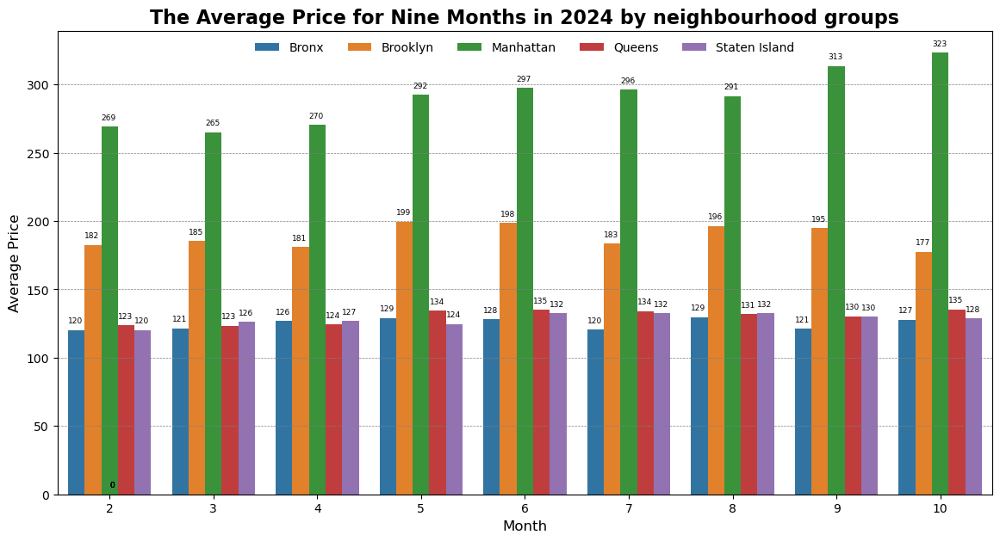

In [136]:
plt.figure(figsize=(14,7))
ax = sns.barplot(agg_df_4, hue='neighbourhood_group', x='month', y='avg_price')
plt.xlabel('Month', size=12)
plt.ylabel('Average Price', size=12)
plt.title('The Average Price for Nine Months in 2024 by neighbourhood groups', size=16, weight='bold')
plt.grid(axis='y', color='grey', linestyle='--', lw=0.5)
plt.legend(loc='upper center', ncol=5, frameon=False, fontsize=10)
for bar in ax.patches:
    yval = bar.get_height()
    ax.text(bar.get_x(), yval+5, f'{int(yval)}', size=6.5)
plt.show()

In [138]:
reg_df_2_cols_minus = dfs['room_type'].value_counts().nlargest(4).index
reg_df_2_cols_minus

Index(['Entire home/apt', 'Private room', 'Shared room', 'Hotel room'], dtype='object', name='room_type')

In [140]:
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

reg_df_2 = dfs[(dfs['price']>0)&(dfs['price']<dfs['price'].quantile(0.95))&(dfs['year']==2024)&(dfs['month']!=11)
                &(dfs['room_type'].isin(reg_df_2_cols_minus))]
reg_df_2_cols = ['price', 'latitude', 'longitude', 'reviews_per_month', 'availability_365', 'room_type']
reg_df_2 = reg_df_2[reg_df_2_cols]
reg_df_2 = pd.get_dummies(reg_df_2, columns=['room_type'], drop_first=True)
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)

params_grid_2 = {
    'n_estimators': [100, 200, 500],
    'max_depth': [10, 20, None],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}
grid_search_2 = GridSearchCV(
    RandomForestRegressor(random_state=42),
    params_grid_2,
    cv=5,
    scoring='neg_mean_absolute_error',
    n_jobs=-1
)
grid_search_2.fit(x_train, y_train)
best_params_2 = grid_search_2.best_params_
print('Best Parameters: ', best_params_2)

best_model_2 = RandomForestRegressor(**best_params_2, random_state=42)
best_model_2.fit(x_train, y_train)
y_pred_2 = best_model_2.predict(x_test)

print('MAE: ', mean_absolute_error(y_test, y_pred))
print('MSE: ', mean_squared_error(y_test, y_pred))
print('R2: ', r2_score(y_test, y_pred))

# Quite time consuming.

Best Parameters:  {'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 500}
MAE:  49.58763920989378
MSE:  4344.627076274985
R2:  0.5271595340539426


In [141]:
dfs.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 427674 entries, 0 to 427673
Data columns (total 20 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   id                              427674 non-null  object 
 1   name                            427640 non-null  object 
 2   host_id                         427667 non-null  object 
 3   host_name                       427594 non-null  object 
 4   neighbourhood_group             427666 non-null  object 
 5   neighbourhood                   427666 non-null  object 
 6   latitude                        427364 non-null  float64
 7   longitude                       426312 non-null  float64
 8   room_type                       427080 non-null  object 
 9   price                           281849 non-null  float64
 10  minimum_nights                  427503 non-null  float64
 11  number_of_reviews               426368 non-null  float64
 12  last_review     

In [142]:
test_df_plus = dfs[(dfs['price']>0)&(dfs['price']<dfs['price'].quantile(0.95))&(dfs['month']==11)&(dfs['room_type'].isin(reg_df_2_cols_minus))]
test_df_plus = test_df_plus[reg_df_2_cols]
test_df_plus = pd.get_dummies(test_df_plus, columns=['room_type'], drop_first=True)
x_test_11 = test_df_plus.drop('price', axis=1)
y_test_11 = test_df_plus['price']
y_pred_11 = best_model_2.predict(x_test_11)

print('MAE: ', mean_absolute_error(y_test_11, y_pred_11))
print('MSE: ', mean_squared_error(y_test_11, y_pred_11))
print('R2: ', r2_score(y_test_11, y_pred_11))

MAE:  87.75162530561893
MSE:  11161.93449327547
R2:  0.060778171332361075


In [146]:
top_4_end = dfs['room_type'].value_counts().nlargest(4)
pie_df = dfs[(dfs['room_type'].isin(top_4_end.index))&(dfs['price']>0)]
print(pie_df['room_type'].value_counts())
print(pie_df['price'].sort_values())

room_type
Entire home/apt    153417
Private room       120611
Shared room          4263
Hotel room           2202
Name: count, dtype: int64
238811         8.0
375594         8.0
423895         8.0
381497         8.0
275803         8.0
            ...   
175707    100000.0
324479    100000.0
99654     100000.0
65158     100000.0
176335    100000.0
Name: price, Length: 280493, dtype: float64


In [148]:
agg_df_end = pie_df.groupby(['year', 'room_type']).agg(
    num_room = ('room_type', 'count')
).reset_index()
agg_df_end

,year,room_type,num_room
0,2019,Entire home/apt,25134
1,2019,Private room,22024
2,2019,Shared room,1149
3,2024,Entire home/apt,128283
4,2024,Hotel room,2202
5,2024,Private room,98587
6,2024,Shared room,3114


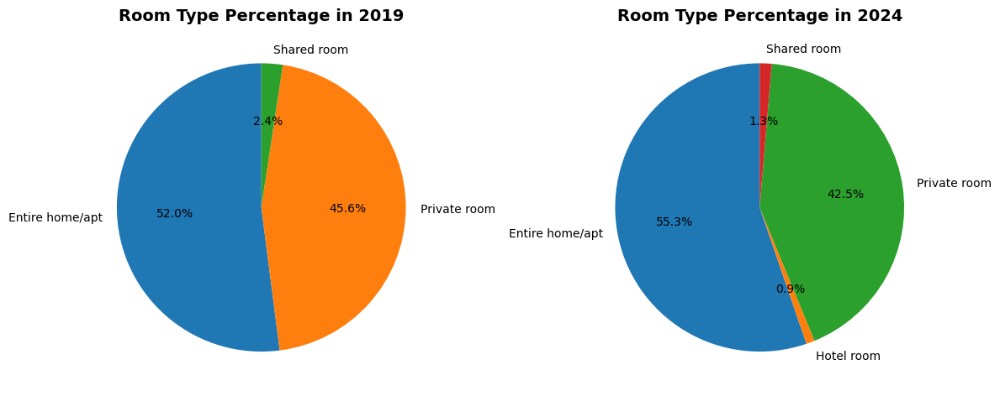

In [150]:
fig, ax = plt.subplots(ncols=2, nrows=1, figsize=(12,6))
ax = ax.flatten()
ax[0].pie(agg_df_end[agg_df_end['year']==2019]['num_room'], labels=agg_df_end[agg_df_end['year']==2019]['room_type'], autopct='%1.1f%%', startangle=90)
ax[0].set_title('Room Type Percentage in 2019', size=14, weight='bold')
ax[1].pie(agg_df_end[agg_df_end['year']==2024]['num_room'], labels=agg_df_end[agg_df_end['year']==2024]['room_type'], autopct='%1.1f%%', startangle=90)
ax[1].set_title('Room Type Percentage in 2024', size=14, weight='bold')
plt.tight_layout()
plt.show()

In [159]:
from scipy.stats import ttest_ind
t_stat, p_val = ttest_ind(pie_df[pie_df['year']==2019]['price'], pie_df[pie_df['year']==2024]['price'])
print('T-statistic: ', t_stat)
print('P-value: ', p_val)

T-statistic:  -16.61544274363647
P-value:  5.768837982658928e-62
